# YOLOv12_Fine-Tuning

In [1]:
!pip install ultralytics
!pip install -q git+https://github.com/sunsmarterjie/yolov12.git supervision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 22.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 49.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 18.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 42.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 96.6 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling 

## 🔹 Downloading YOLOv12-Compatible Dataset from Roboflow using Python

Here are a few use cases for this project

- **Auto Repair Assistance**

- **Car Manufacturing Quality Control**

- **Automobile Insurance Claim Inspection**

- **Vehicle Classification Systems**

- **Autonomous Vehicle Development**

In [2]:
# https://universe.roboflow.com/sammy/car-components-dataset

!pip install roboflow --q

from roboflow import Roboflow
rf = Roboflow(api_key="*******")
project = rf.workspace("sammy").project("car-components-dataset")
version = project.version(11)
dataset = version.download("yolov12")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.8/85.8 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 18.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 129.0 MB/s eta 0:00:00
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Car-Components-Dataset-11 in yolov12:: 100%|██████████| 12548/12548 [00:02<00:00, 5290.10it/s]


In [3]:
import os
import glob

# Base directory where the dataset was downloaded
base_dir = "/content/Car-Components-Dataset-11"  # Adjust if necessary

# Function to count images in a directory
def count_images(directory):
    return len(glob.glob(os.path.join(directory, "*.jpg")))  # or *.png depending on image type

splits = ["train", "valid", "test"]

for split in splits:
    image_dir = os.path.join(base_dir, split, "images")
    count = count_images(image_dir)
    print(f"{split.capitalize()} images: {count}")


Train images: 5908
Valid images: 238
Test images: 122


# 🔹 Visualizing Class Distribution in YOLOv12 Dataset Splits Using Matplotlib

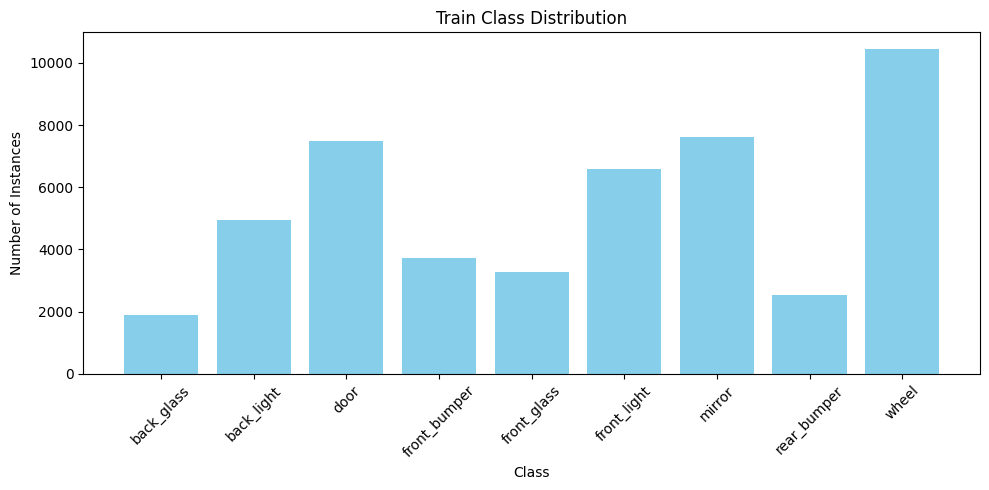

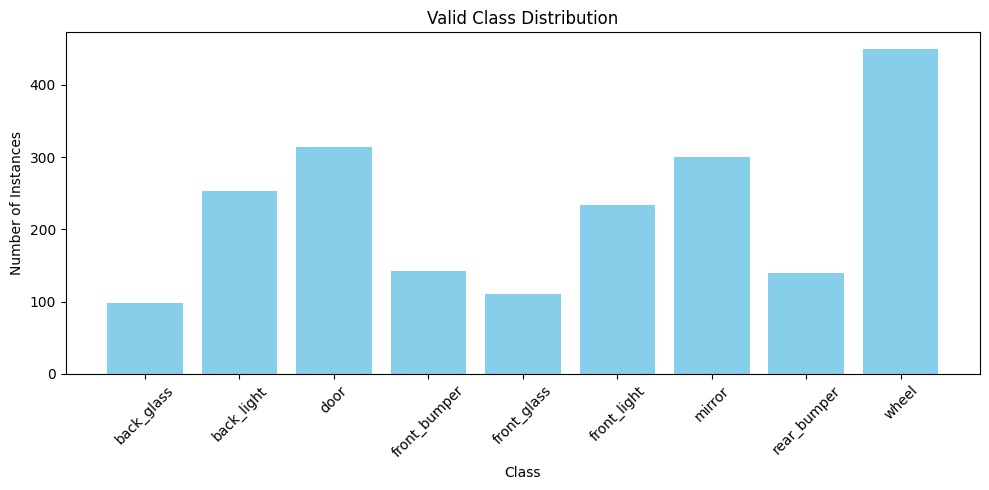

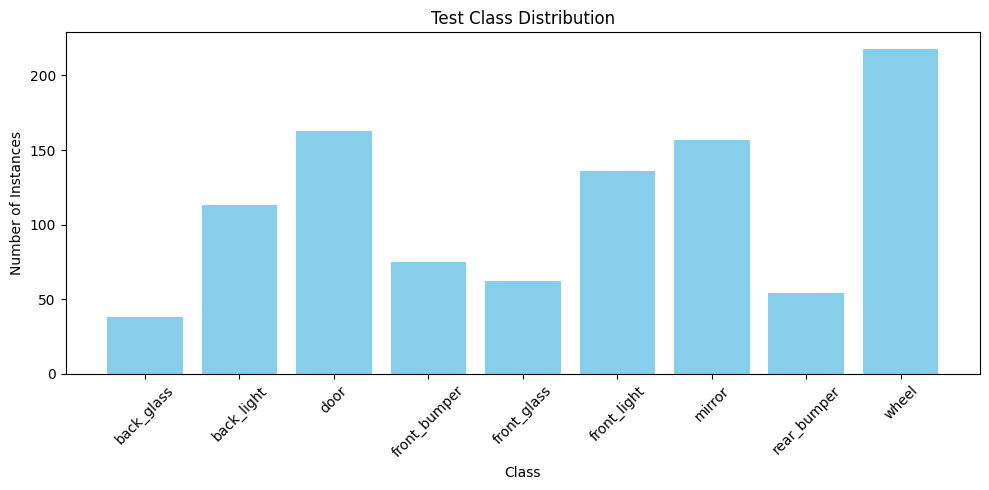

In [4]:
import os
import glob
import matplotlib.pyplot as plt
from collections import Counter

# Base directory where the dataset is downloaded
base_dir = "/content/Car-Components-Dataset-11"

# Class names as per your YAML
class_names = ['back_glass', 'back_light', 'door', 'front_bumper', 'front_glass',
               'front_light', 'mirror', 'rear_bumper', 'wheel']

# Function to count class occurrences in a split
def count_classes(label_dir, num_classes):
    class_counts = Counter()
    label_files = glob.glob(os.path.join(label_dir, "*.txt"))
    for label_file in label_files:
        with open(label_file, "r") as f:
            for line in f:
                class_id = int(line.strip().split()[0])
                class_counts[class_id] += 1
    # Ensure all classes are present (even if 0)
    return [class_counts.get(i, 0) for i in range(num_classes)]

# Process each split
splits = ["train", "valid", "test"]
split_counts = {}

for split in splits:
    label_dir = os.path.join(base_dir, split, "labels")
    counts = count_classes(label_dir, len(class_names))
    split_counts[split] = counts

# Plotting
for split in splits:
    plt.figure(figsize=(10, 5))
    plt.bar(class_names, split_counts[split], color='skyblue')
    plt.xticks(rotation=45)
    plt.title(f"{split.capitalize()} Class Distribution")
    plt.xlabel("Class")
    plt.ylabel("Number of Instances")
    plt.tight_layout()
    plt.show()


## 🔹 Visualizing YOLOv12 Bounding Boxes on Random Sample Images Using PIL and Matplotlib

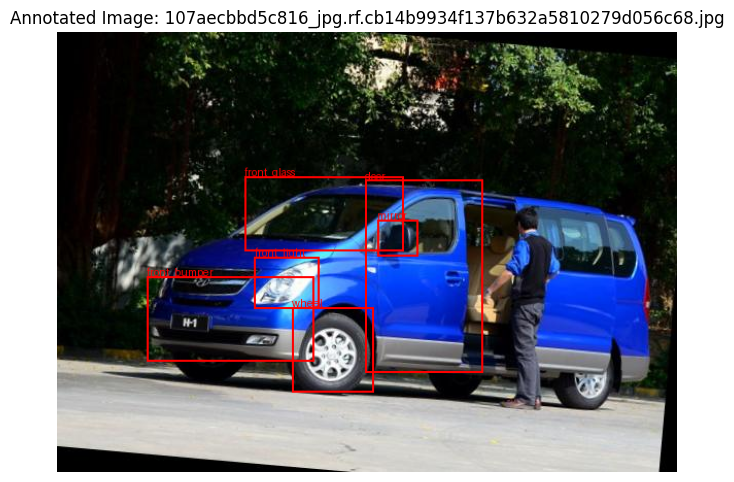

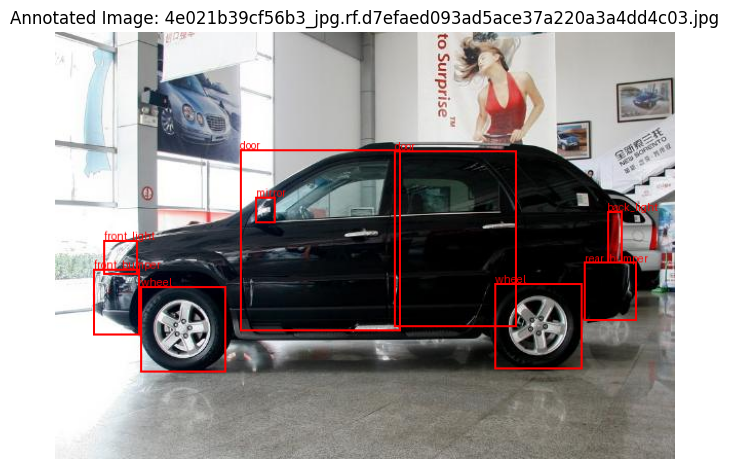

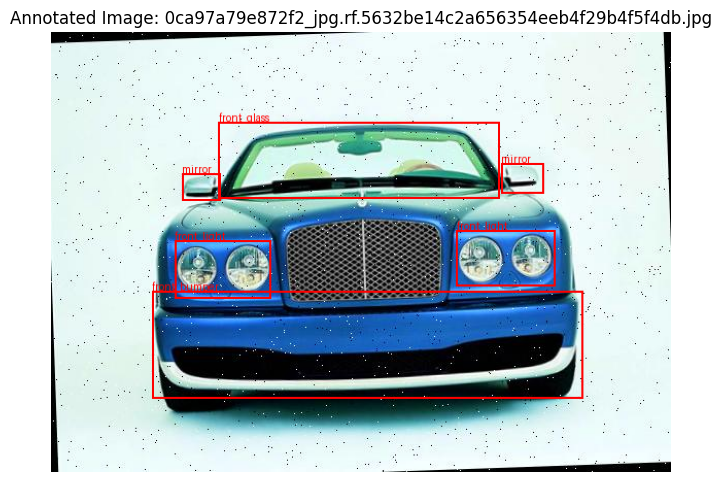

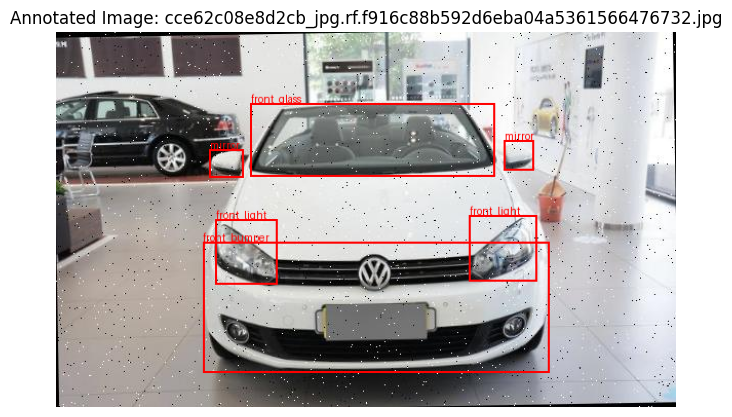

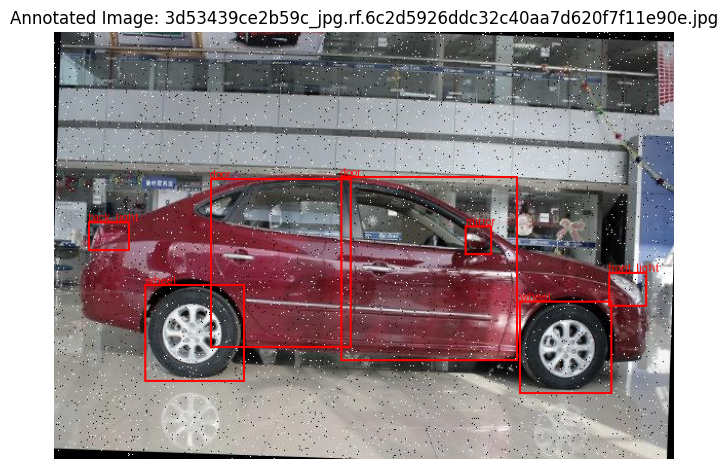

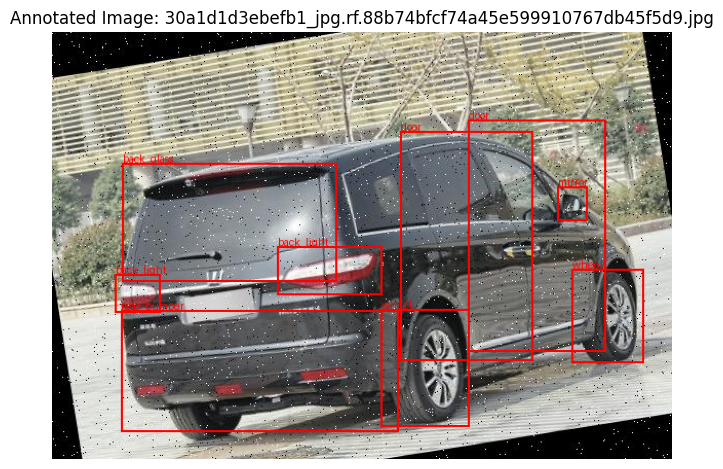

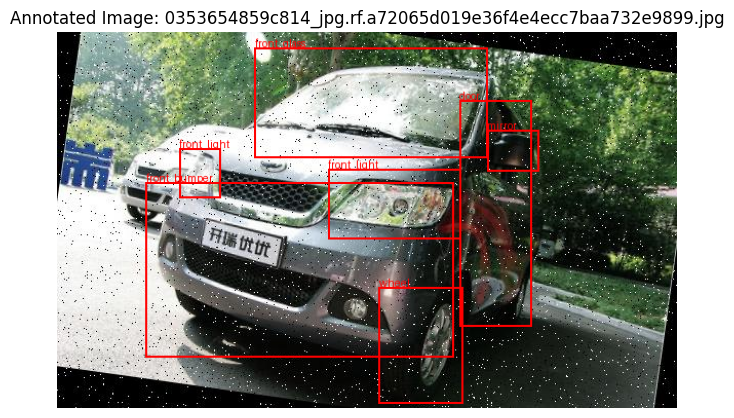

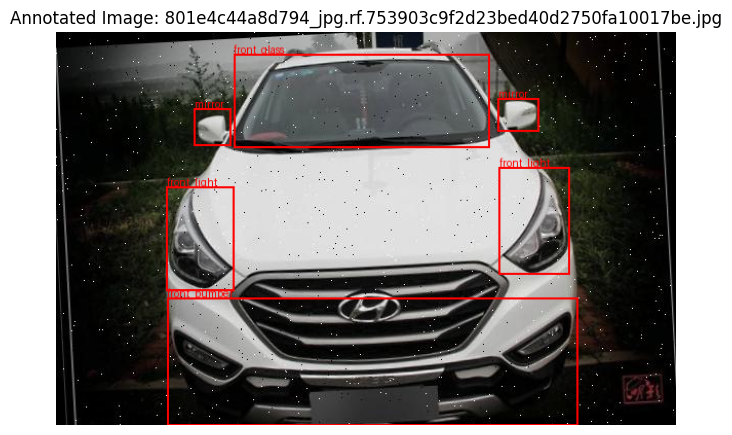

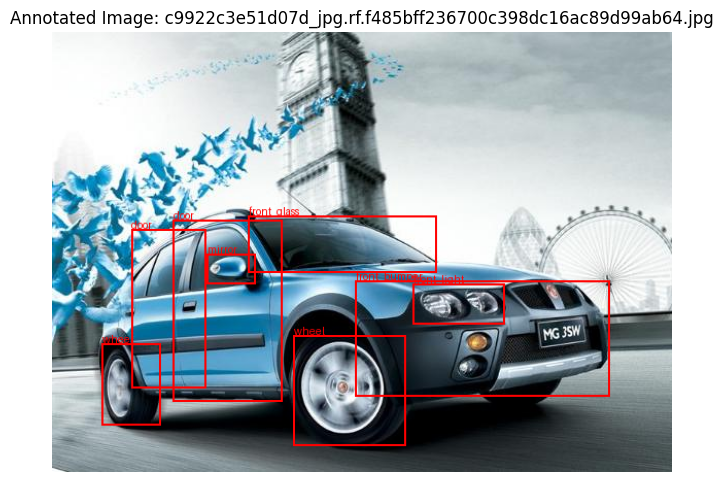

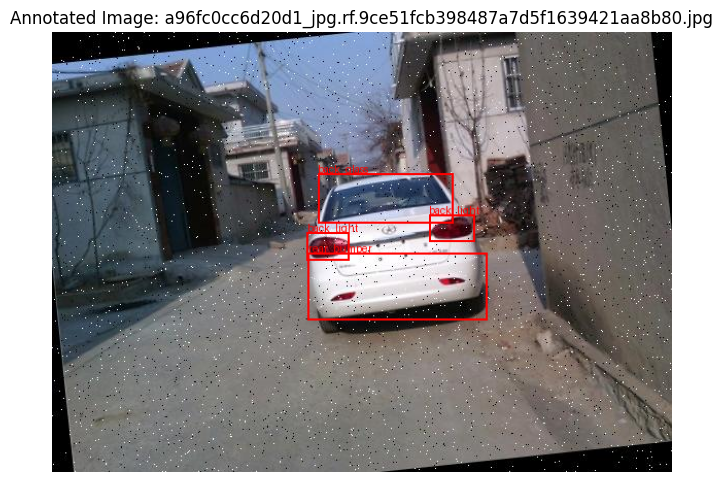

In [5]:
import os
import random
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt

# Define class names (ensure these match your dataset's classes)
class_names = ['back_glass', 'back_light', 'door', 'front_bumper', 'front_glass', 'front_light', 'mirror', 'rear_bumper', 'wheel']

# Function to load and display annotated images
def display_annotated_images(images_path, labels_path, num_images=5, class_names=None):
    """
    Display images with bounding box annotations from YOLO format label files.

    Args:
        images_path (str): Path to directory containing images
        labels_path (str): Path to directory containing label files
        num_images (int): Number of random images to display (default: 5)
        class_names (list): List of class names corresponding to class IDs
    """
    # Get list of image files
    image_files = [f for f in os.listdir(images_path) if f.endswith('.jpg') or f.endswith('.png')]

    # Handle case where there are fewer images than requested
    num_images = min(num_images, len(image_files))
    selected_images = random.sample(image_files, num_images)

    for image_file in selected_images:
        # Get paths for image and corresponding label file
        image_path = os.path.join(images_path, image_file)
        label_file = os.path.splitext(image_file)[0] + '.txt'
        label_path = os.path.join(labels_path, label_file)

        # Open the image
        with Image.open(image_path) as img:
            draw = ImageDraw.Draw(img)
            width, height = img.size

            # Check if the label file exists
            if os.path.exists(label_path):
                with open(label_path, 'r') as f:
                    for line in f:
                        parts = line.strip().split()
                        if len(parts) >= 5:  # YOLO format: class_id, x_center, y_center, width, height
                            class_id, x_center, y_center, box_width, box_height = map(float, parts[:5])
                            class_id = int(class_id)
                            # Convert YOLO format to pixel coordinates
                            x_center *= width
                            y_center *= height
                            box_width *= width
                            box_height *= height
                            x0 = x_center - box_width / 2
                            y0 = y_center - box_height / 2
                            x1 = x_center + box_width / 2
                            y1 = y_center + box_height / 2
                            # Draw the bounding box
                            draw.rectangle([x0, y0, x1, y1], outline="red", width=2)
                            # Draw the class label if class_names is provided
                            if class_names and class_id < len(class_names):
                                draw.text((x0, y0 - 10), class_names[class_id], fill="red")
                            else:
                                draw.text((x0, y0 - 10), str(class_id), fill="red")

            # Display the image
            plt.figure(figsize=(8, 6))
            plt.imshow(img)
            plt.axis('off')
            plt.title(f"Annotated Image: {image_file}")
            plt.show()

# Example usage:
display_annotated_images(
    images_path="/content/Car-Components-Dataset-11/train/images",
    labels_path="/content/Car-Components-Dataset-11/train/labels",
    num_images=10,
    class_names=['back_glass', 'back_light', 'door', 'front_bumper', 'front_glass', 'front_light', 'mirror', 'rear_bumper', 'wheel']
)

# 🔹 Data Augmentation for YOLOv12 Datasets Using Albumentations

In [6]:
import os
import cv2
import random
import albumentations as A
from albumentations.pytorch import ToTensorV2
import matplotlib.pyplot as plt

# Set paths
base_path = "/content/Car-Components-Dataset-11/train"
img_dir = os.path.join(base_path, "images")
label_dir = os.path.join(base_path, "labels")
augmented_dir = "augmented_data"
os.makedirs(augmented_dir, exist_ok=True)
os.makedirs(os.path.join(augmented_dir, "images"), exist_ok=True)
os.makedirs(os.path.join(augmented_dir, "labels"), exist_ok=True)

# Class names
class_names=['back_glass', 'back_light', 'door', 'front_bumper', 'front_glass', 'front_light', 'mirror', 'rear_bumper', 'wheel']

A new version of Albumentations is available: '2.0.8' (you have '2.0.7'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.


In [7]:
# Albumentations pipeline
transform = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.5),
    # A.Rotate(limit=10, p=0.3),
    A.GaussianBlur(p=0.2),
    A.RandomGamma(p=0.2),
    A.HueSaturationValue(p=0.3),
    # A.Resize(640, 640)
], bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

# Apply augmentations
def augment_image(image_path, label_path, save_prefix):
    image = cv2.imread(image_path)
    h, w = image.shape[:2]
    label_lines = open(label_path).read().strip().split('\n')

    bboxes = []
    class_labels = []
    for line in label_lines:
        cls, x, y, bw, bh = map(float, line.strip().split())
        bboxes.append([x, y, bw, bh])
        class_labels.append(int(cls))

    transformed = transform(image=image, bboxes=bboxes, class_labels=class_labels)

    aug_img = transformed['image']
    aug_bboxes = transformed['bboxes']
    aug_labels = transformed['class_labels']

    # Save augmented image
    aug_img_path = os.path.join(augmented_dir, "images", f"{save_prefix}.jpg")
    cv2.imwrite(aug_img_path, aug_img)

    # Save label file
    aug_label_path = os.path.join(augmented_dir, "labels", f"{save_prefix}.txt")
    with open(aug_label_path, 'w') as f:
        for bbox, cls in zip(aug_bboxes, aug_labels):
            f.write(f"{cls} {' '.join(map(str, bbox))}\n")

# Generate and display samples
image_files = [f for f in os.listdir(img_dir) if f.endswith(".jpg")]
random.shuffle(image_files)

In [8]:
for i, img_file in enumerate(image_files[:500]):
    img_path = os.path.join(img_dir, img_file)
    label_path = os.path.join(label_dir, img_file.replace(".jpg", ".txt"))
    augment_image(img_path, label_path, f"aug_{i}")

In [9]:
import os

# Define paths
original_train_images = "/content/Car-Components-Dataset-11/train/images"
original_train_labels = "/content/Car-Components-Dataset-11/train/labels"
augmented_images = "/content/augmented_data/images"
augmented_labels = "/content/augmented_data/labels"

# Count images and labels
def count_files(path, ext=".jpg"):
    return len([f for f in os.listdir(path) if f.endswith(ext)])

# Get counts
orig_img_count = count_files(original_train_images, ".jpg")
orig_lbl_count = count_files(original_train_labels, ".txt")

aug_img_count = count_files(augmented_images, ".jpg")
aug_lbl_count = count_files(augmented_labels, ".txt")

# Print results
print("📊 Dataset Size Comparison")
print(f"Original Training Images: {orig_img_count}")
print(f"Original Training Labels: {orig_lbl_count}")
print("———")
print(f"Augmented Images:         {aug_img_count}")
print(f"Augmented Labels:         {aug_lbl_count}")
print("———")
print(f"Total After Augmentation: {orig_img_count + aug_img_count} images, {orig_lbl_count + aug_lbl_count} labels")


📊 Dataset Size Comparison
Original Training Images: 5908
Original Training Labels: 5908
———
Augmented Images:         500
Augmented Labels:         500
———
Total After Augmentation: 6408 images, 6408 labels


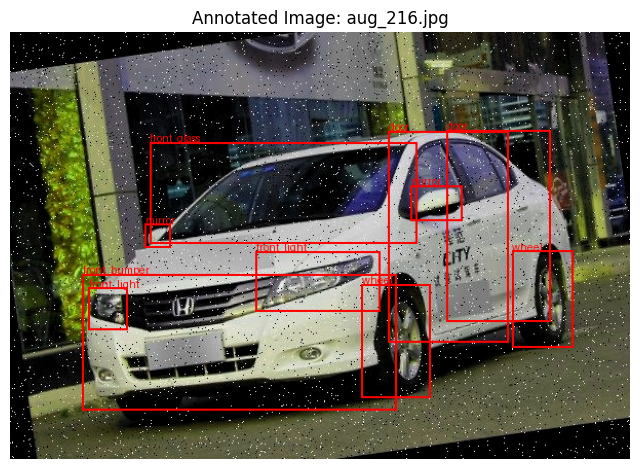

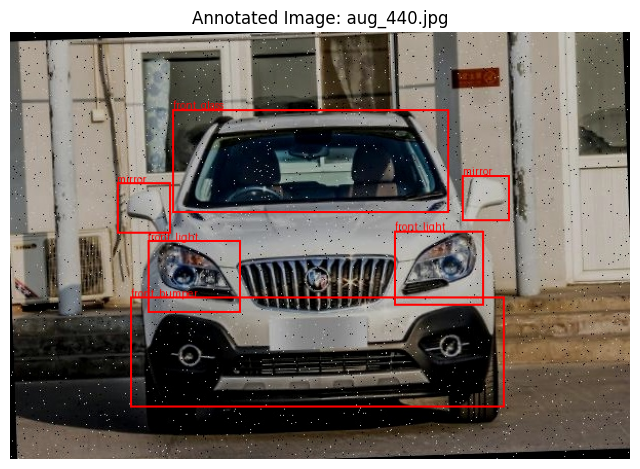

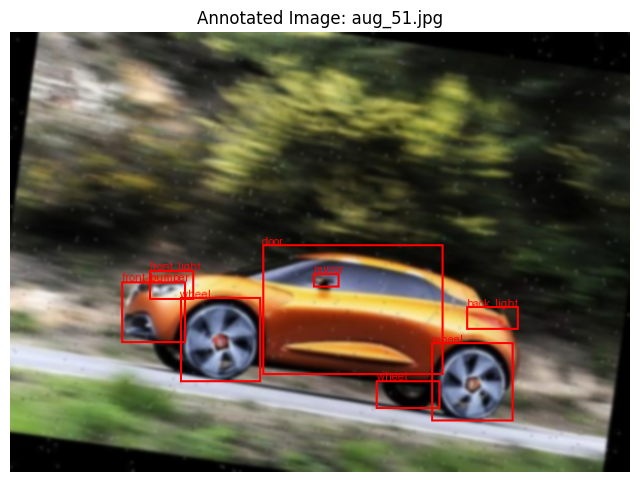

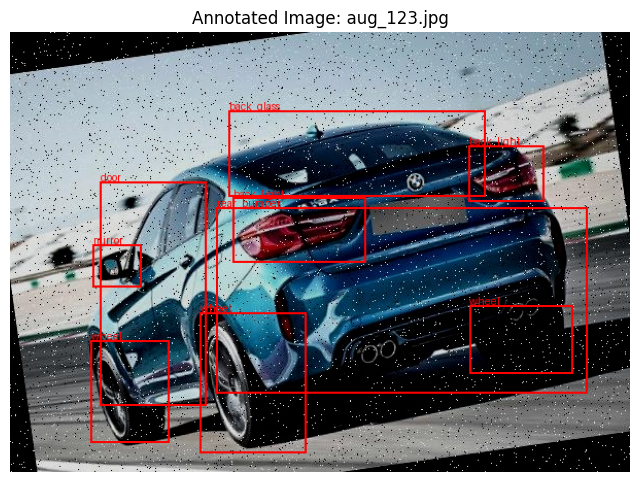

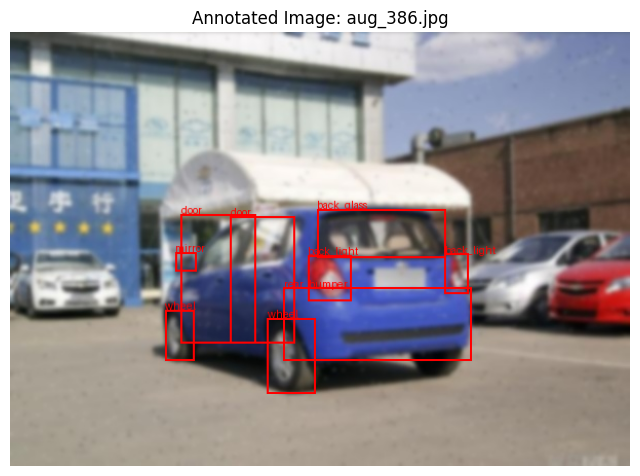

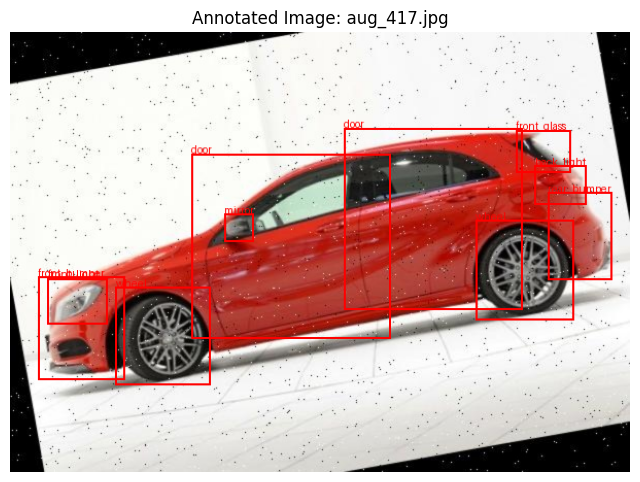

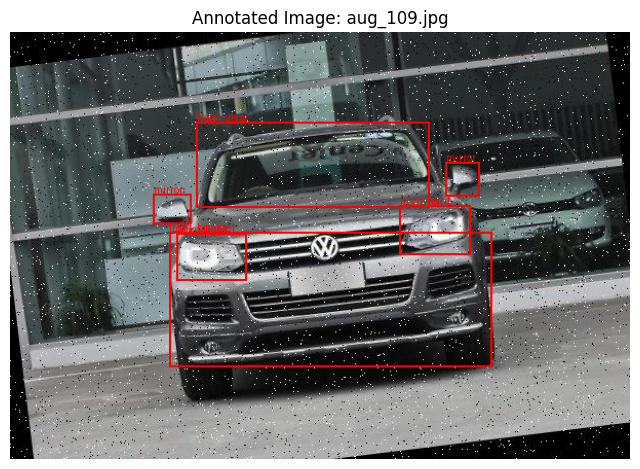

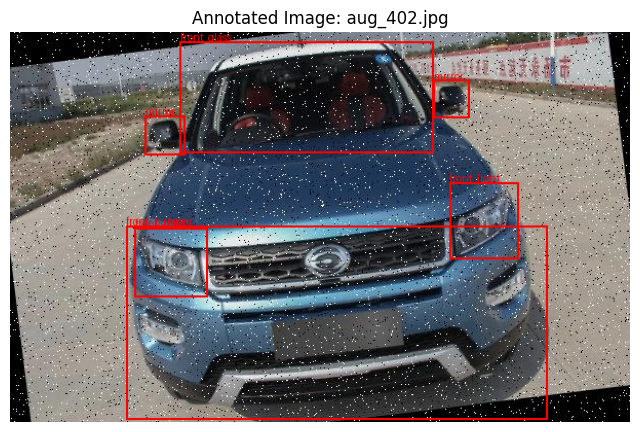

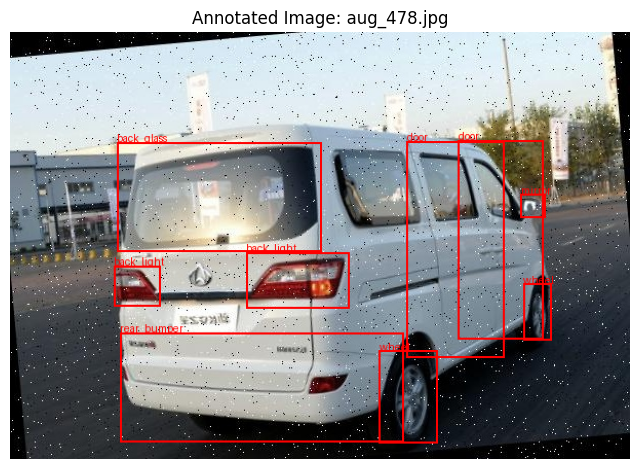

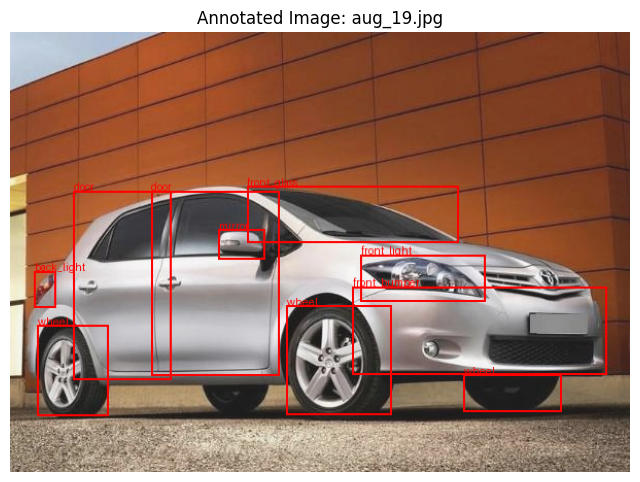

In [10]:
display_annotated_images(
    images_path="/content/augmented_data/images",
    labels_path="/content/augmented_data/labels",
    num_images=10,
    class_names=['back_glass', 'back_light', 'door', 'front_bumper', 'front_glass', 'front_light', 'mirror', 'rear_bumper', 'wheel']
)

# 🔹  Merging Augmented Data into YOLOv12 Training Set Using Python

In [11]:
import shutil
import os

# Define source and destination directories
aug_img_dir = "/content/augmented_data/images"
aug_lbl_dir = "/content/augmented_data/labels"
train_img_dir = "/content/Car-Components-Dataset-11/train/images"
train_lbl_dir = "/content/Car-Components-Dataset-11/train/labels"

# Create counters
img_count, lbl_count = 0, 0

# Copy images
for file in os.listdir(aug_img_dir):
    if file.endswith(".jpg"):
        shutil.copy(os.path.join(aug_img_dir, file), os.path.join(train_img_dir, file))
        img_count += 1

# Copy labels
for file in os.listdir(aug_lbl_dir):
    if file.endswith(".txt"):
        shutil.copy(os.path.join(aug_lbl_dir, file), os.path.join(train_lbl_dir, file))
        lbl_count += 1

print(f"✅ Merged {img_count} images and {lbl_count} labels into the training set.")

✅ Merged 500 images and 500 labels into the training set.


In [12]:
# Get counts
orig_img_count = count_files(original_train_images, ".jpg")
orig_lbl_count = count_files(original_train_labels, ".txt")

# Print results
print("📊 Dataset Size Comparison")
print(f"Original Training Images: {orig_img_count}")
print(f"Original Training Labels: {orig_lbl_count}")

📊 Dataset Size Comparison
Original Training Images: 6408
Original Training Labels: 6408


## 🔹 Fine-Tuning a YOLOv12 Large Model on a Custom Car Components Dataset

In [13]:
from ultralytics import YOLO
import time

# Load the large model
model = YOLO('yolov12l.pt')
# Fine-tuning start
start_time = time.time()

# Train the model
model.train(
    data="/content/Car-Components-Dataset-11/data.yaml",  # path to dataset config
    epochs=10,
    imgsz=640,
    batch=8,
    workers=4,
    name="yolov12-car-component-finetune",
    verbose=True
)

end_time = time.time()
print(f"🕒 Total fine-tuning time: {(end_time - start_time)/60:.2f} minutes")


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/yolov12/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
FlashAttention is not available on this device. Using scaled_dot_product_attention instead.


100%|██████████| 51.4M/51.4M [00:00<00:00, 122MB/s]


New https://pypi.org/project/ultralytics/8.3.146 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.63 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov12l.pt, data=/content/Car-Components-Dataset-11/data.yaml, epochs=10, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=4, project=None, name=yolov12-car-component-finetune, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks

100%|██████████| 755k/755k [00:00<00:00, 25.3MB/s]


Overriding model.yaml nc=80 with nc=9

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     37120  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2, 1, 2]         
  2                  -1  2    173824  ultralytics.nn.modules.block.C3k2            [128, 256, 2, True, 0.25]     
  3                  -1  1    147968  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2, 1, 4]        
  4                  -1  2    691712  ultralytics.nn.modules.block.C3k2            [256, 512, 2, True, 0.25]     
  5                  -1  1   2360320  ultralytics.nn.modules.conv.Conv             [512, 512, 3, 2]              
  6                  -1  4   4540416  ultralytics.nn.modules.block.A2C2f           [512, 512, 4, True, 4, True, 1.5]
  7                  -1  1   2360320  ultralyt

100%|██████████| 5.26M/5.26M [00:00<00:00, 69.1MB/s]


AMP: checks passed ✅


train: Scanning /content/Car-Components-Dataset-11/train/labels... 6408 images, 0 backgrounds, 0 corrupt: 100%|██████████| 6408/6408 [00:02<00:00, 2381.41it/s]


train: New cache created: /content/Car-Components-Dataset-11/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


Argument(s) 'quality_lower' are not valid for transform ImageCompression
val: Scanning /content/Car-Components-Dataset-11/valid/labels... 238 images, 0 backgrounds, 0 corrupt: 100%|██████████| 238/238 [00:00<00:00, 1243.60it/s]


val: New cache created: /content/Car-Components-Dataset-11/valid/labels.cache
Plotting labels to runs/detect/yolov12-car-component-finetune/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000769, momentum=0.9) with parameter groups 221 weight(decay=0.0), 230 weight(decay=0.0005), 227 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12-car-component-finetune
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


Argument(s) 'quality_lower' are not valid for transform ImageCompression



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      9.33G       1.27     0.9683      1.335         70        640: 100%|██████████| 801/801 [10:35<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:06<00:00,  2.37it/s]

                   all        238       2041      0.872      0.818       0.89      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      9.32G      1.199     0.6887      1.277         66        640: 100%|██████████| 801/801 [10:16<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:05<00:00,  2.95it/s]

                   all        238       2041      0.881      0.877      0.917      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      9.33G      1.152     0.6312      1.255         64        640: 100%|██████████| 801/801 [10:11<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:05<00:00,  2.94it/s]

                   all        238       2041      0.911      0.874      0.931      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      9.32G      1.099     0.5728      1.217         67        640: 100%|██████████| 801/801 [10:10<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:05<00:00,  2.91it/s]

                   all        238       2041       0.93      0.893      0.942      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      9.28G      1.036     0.5207      1.179         56        640: 100%|██████████| 801/801 [10:12<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:05<00:00,  2.91it/s]

                   all        238       2041      0.915      0.882       0.94      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      9.25G     0.9836     0.4797      1.146         63        640: 100%|██████████| 801/801 [10:12<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:05<00:00,  2.94it/s]

                   all        238       2041      0.934      0.913      0.954      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      9.33G     0.9342     0.4424      1.117         66        640: 100%|██████████| 801/801 [10:11<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:05<00:00,  2.95it/s]

                   all        238       2041      0.945      0.916      0.958      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10       9.3G     0.8928     0.4118      1.081         62        640: 100%|██████████| 801/801 [10:12<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:05<00:00,  2.93it/s]

                   all        238       2041       0.95      0.899      0.955      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      9.28G     0.8377     0.3801      1.057         71        640: 100%|██████████| 801/801 [10:11<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:05<00:00,  2.92it/s]

                   all        238       2041      0.941      0.929      0.959      0.735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      9.31G     0.7914     0.3508      1.036         65        640: 100%|██████████| 801/801 [10:11<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:05<00:00,  2.83it/s]

                   all        238       2041      0.939       0.93      0.961      0.741



10 epochs completed in 1.742 hours.
Optimizer stripped from runs/detect/yolov12-car-component-finetune/weights/last.pt, 53.7MB
Optimizer stripped from runs/detect/yolov12-car-component-finetune/weights/best.pt, 53.7MB

Validating runs/detect/yolov12-car-component-finetune/weights/best.pt...
Ultralytics 8.3.63 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12l summary (fused): 674 layers, 26,400,491 parameters, 0 gradients, 82.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:06<00:00,  2.22it/s]


                   all        238       2041      0.939       0.93      0.961      0.741
            back_glass         98         98      0.959      0.969      0.969      0.814
            back_light        160        253      0.917      0.858      0.917      0.688
                  door        184        314      0.924      0.967      0.979      0.818
          front_bumper        140        143      0.943      0.909      0.946      0.713
           front_glass        110        110      0.966      0.955      0.978      0.845
           front_light        151        234      0.926      0.905      0.946      0.704
                mirror        222        300      0.936      0.922       0.96      0.612
           rear_bumper        139        139      0.955      0.924      0.978      0.708
                 wheel        201        450      0.923       0.96      0.973      0.768
Speed: 0.2ms preprocess, 17.6ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to runs/detec

## 🔹 Running and Visualizing YOLOv12 Inference on Random Test Images


image 1/1 /content/Car-Components-Dataset-11/test/images/8f385c9e173943_jpg.rf.db3d687b48a504d74df77ce7538766ad.jpg: 448x640 2 doors, 1 front_bumper, 1 front_glass, 2 front_lights, 1 mirror, 2 wheels, 74.6ms
Speed: 2.4ms preprocess, 74.6ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


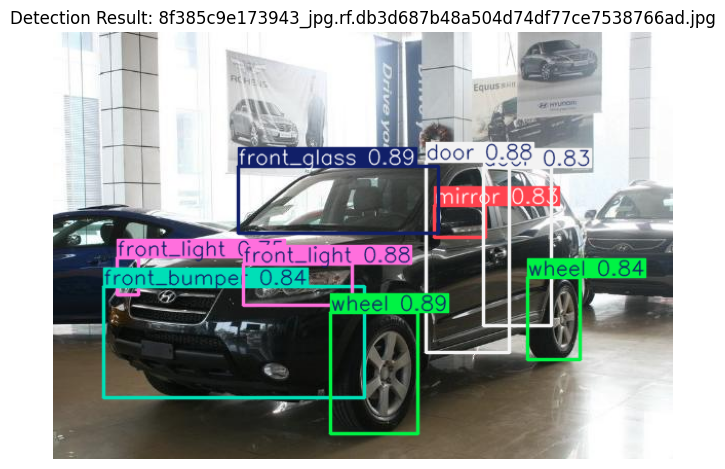


image 1/1 /content/Car-Components-Dataset-11/test/images/95b1920e0c4e79_jpg.rf.061501d09a2ce68dd0615948800a3203.jpg: 480x640 1 door, 1 front_bumper, 1 front_glass, 2 front_lights, 1 mirror, 2 wheels, 112.9ms
Speed: 3.5ms preprocess, 112.9ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


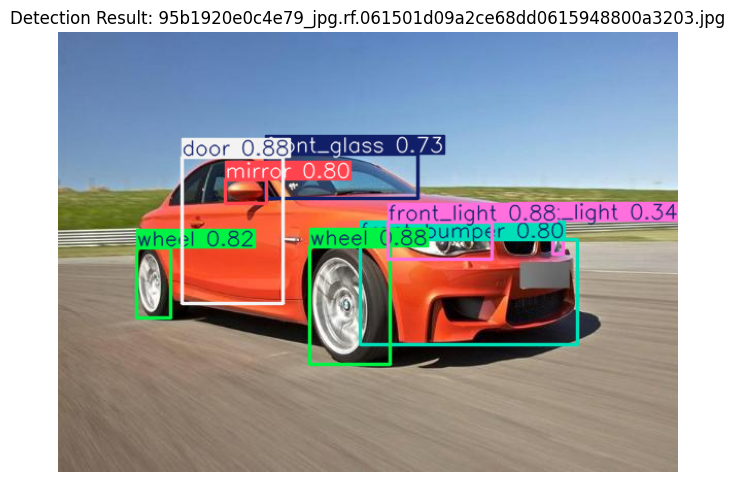


image 1/1 /content/Car-Components-Dataset-11/test/images/0202a747672e2a_jpg.rf.ee8400d08c7bc4fb013d9a2203c79867.jpg: 448x640 2 doors, 1 front_bumper, 1 front_glass, 2 front_lights, 1 mirror, 2 wheels, 48.6ms
Speed: 3.7ms preprocess, 48.6ms inference, 4.1ms postprocess per image at shape (1, 3, 448, 640)


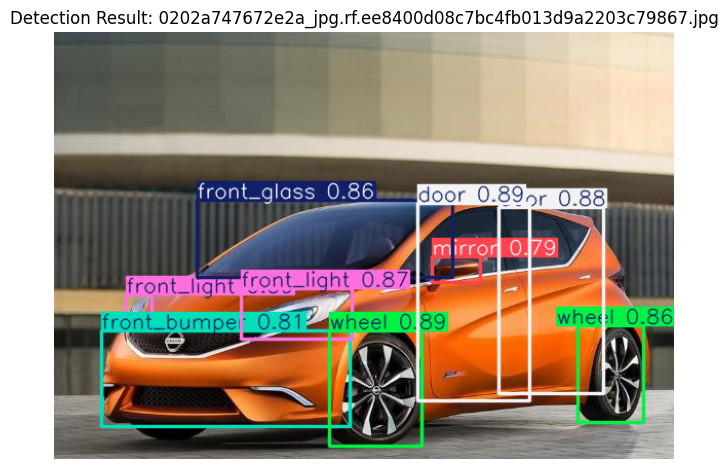


image 1/1 /content/Car-Components-Dataset-11/test/images/510ce80728a81e_jpg.rf.71d7fe244f4adfb8f2ebe3f1804c19ea.jpg: 480x640 1 front_bumper, 1 front_glass, 2 front_lights, 2 mirrors, 60.4ms
Speed: 3.4ms preprocess, 60.4ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


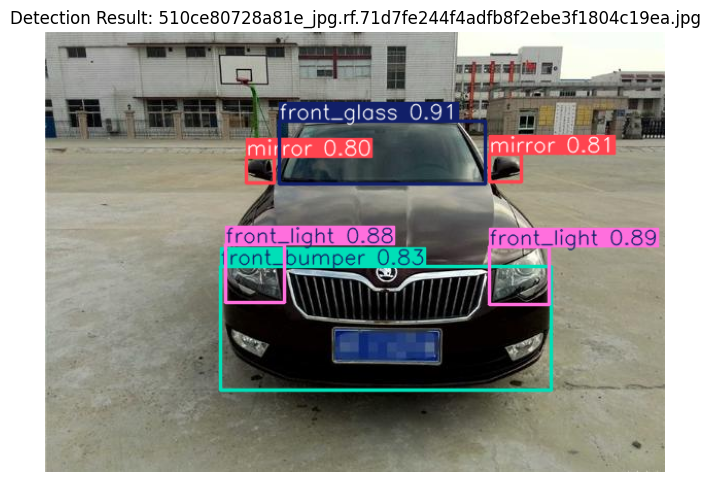


image 1/1 /content/Car-Components-Dataset-11/test/images/88da750d382bb0_jpg.rf.58c344f6e0d46744f03ab1c80102961f.jpg: 448x640 1 back_glass, 2 back_lights, 2 doors, 1 mirror, 1 rear_bumper, 3 wheels, 67.1ms
Speed: 3.4ms preprocess, 67.1ms inference, 2.6ms postprocess per image at shape (1, 3, 448, 640)


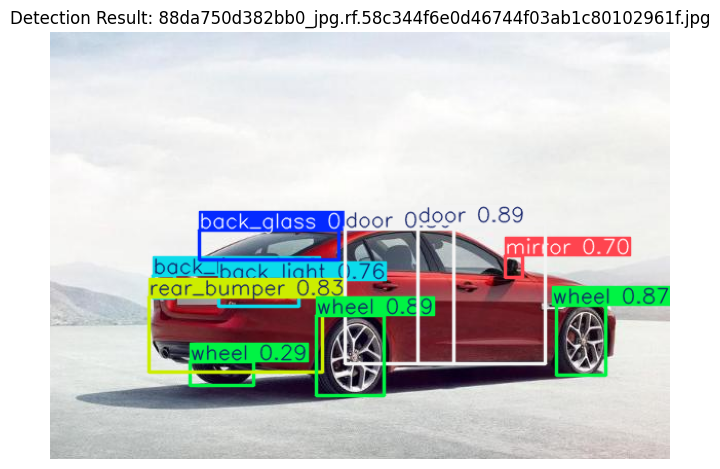


image 1/1 /content/Car-Components-Dataset-11/test/images/9ab732fcb59203_jpg.rf.21fd2be752c396bb80680c31e393f69d.jpg: 448x640 1 back_glass, 2 back_lights, 1 rear_bumper, 68.6ms
Speed: 3.5ms preprocess, 68.6ms inference, 2.1ms postprocess per image at shape (1, 3, 448, 640)


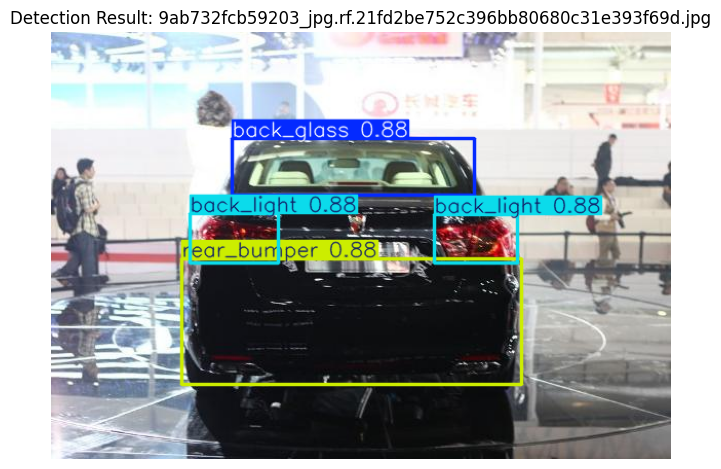


image 1/1 /content/Car-Components-Dataset-11/test/images/b2c9f8881319db_jpg.rf.532ba0c64d158eb93a622f4d2fef7b8f.jpg: 448x640 1 back_glass, 2 back_lights, 2 mirrors, 1 rear_bumper, 2 wheels, 62.5ms
Speed: 5.7ms preprocess, 62.5ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


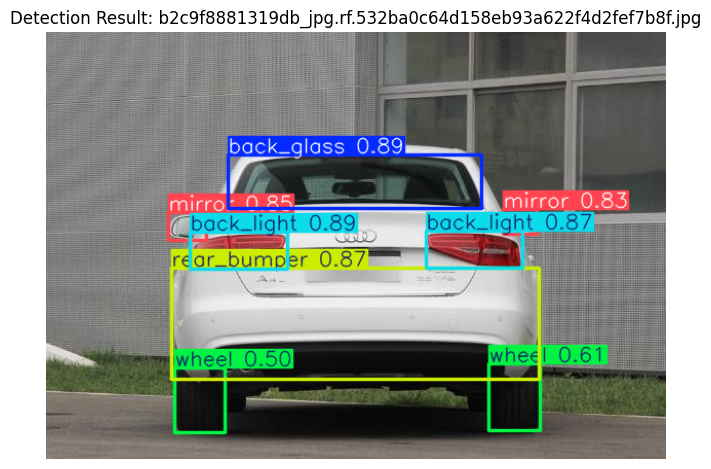


image 1/1 /content/Car-Components-Dataset-11/test/images/10c7d984652602_jpg.rf.72fc45a64307242b5d1c9341571cab4f.jpg: 448x640 1 back_light, 2 doors, 1 front_bumper, 1 front_light, 1 mirror, 1 rear_bumper, 2 wheels, 47.3ms
Speed: 3.1ms preprocess, 47.3ms inference, 2.5ms postprocess per image at shape (1, 3, 448, 640)


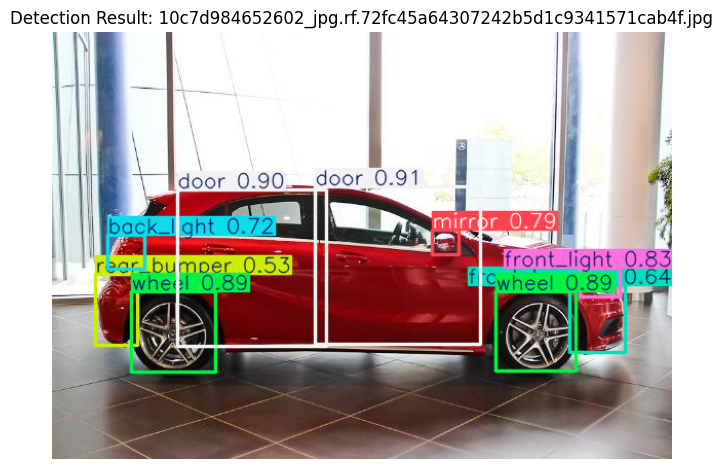


image 1/1 /content/Car-Components-Dataset-11/test/images/4f9582ba9b2d3e_jpg.rf.26d2c5c00676697fcf305b419315ad10.jpg: 480x640 1 back_glass, 2 back_lights, 1 rear_bumper, 67.3ms
Speed: 3.5ms preprocess, 67.3ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


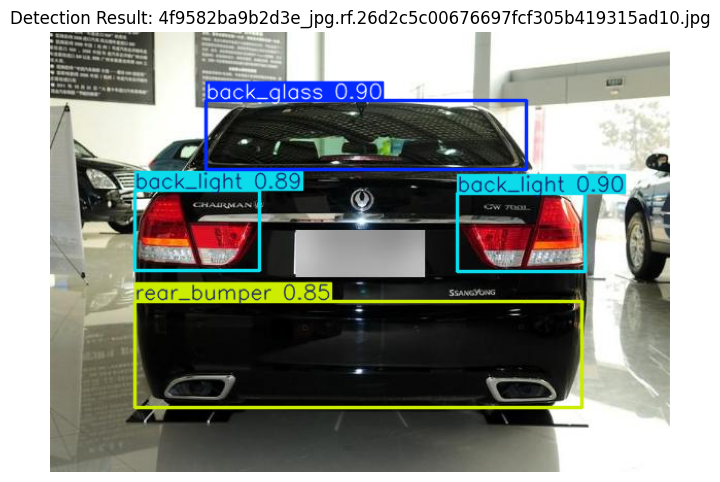


image 1/1 /content/Car-Components-Dataset-11/test/images/13c8fc974eff3a_jpg.rf.0707d071d083f15fc5b8ab4e541252f3.jpg: 480x640 2 doors, 1 front_bumper, 1 front_glass, 2 front_lights, 1 mirror, 2 wheels, 62.8ms
Speed: 3.6ms preprocess, 62.8ms inference, 4.8ms postprocess per image at shape (1, 3, 480, 640)


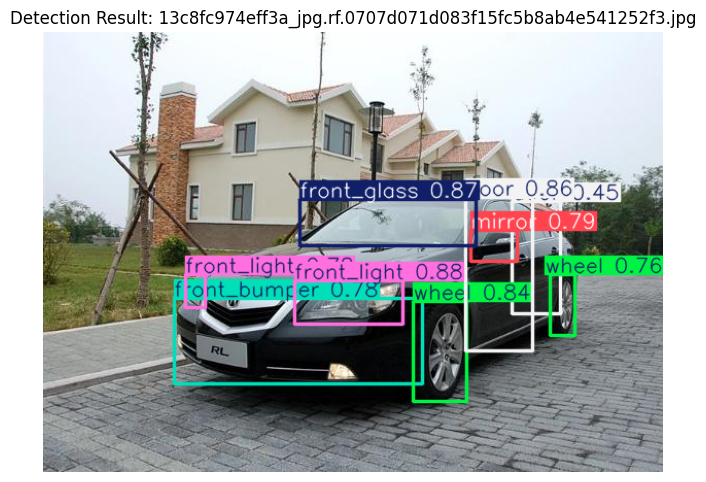


image 1/1 /content/Car-Components-Dataset-11/test/images/7fdfcaaab0496f_jpg.rf.a20bfc7376165604c21470b4517b9868.jpg: 448x640 1 back_glass, 2 back_lights, 2 doors, 1 mirror, 1 rear_bumper, 2 wheels, 68.3ms
Speed: 3.3ms preprocess, 68.3ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


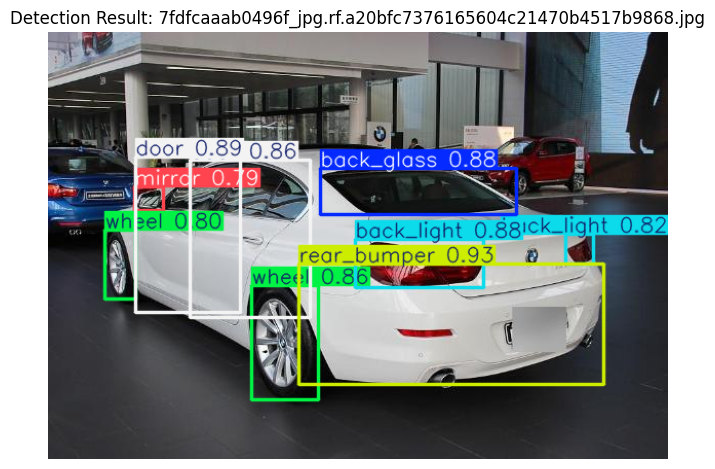


image 1/1 /content/Car-Components-Dataset-11/test/images/092736a6857d3d_jpg.rf.197216278e7e1d582a77694bd4c84baa.jpg: 448x640 1 door, 1 front_bumper, 1 front_glass, 2 front_lights, 2 mirrors, 2 wheels, 67.0ms
Speed: 3.4ms preprocess, 67.0ms inference, 2.1ms postprocess per image at shape (1, 3, 448, 640)


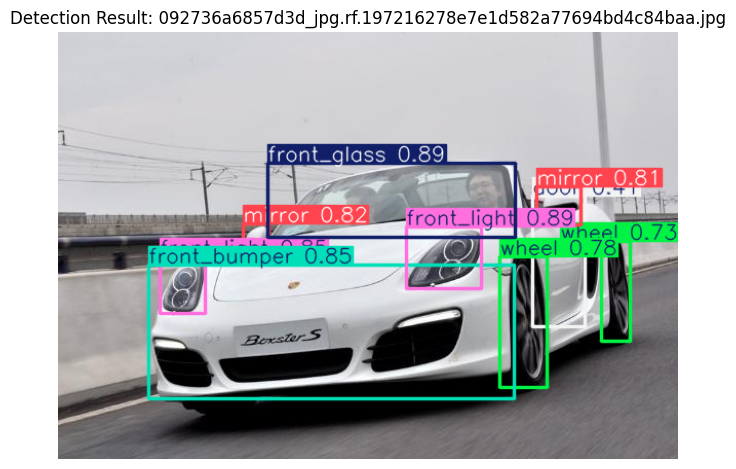


image 1/1 /content/Car-Components-Dataset-11/test/images/3ba2f90addf238_jpg.rf.04192cb5ee52a5c5355851df3e554ba4.jpg: 480x640 1 back_glass, 2 back_lights, 2 doors, 1 mirror, 1 rear_bumper, 3 wheels, 50.4ms
Speed: 3.3ms preprocess, 50.4ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


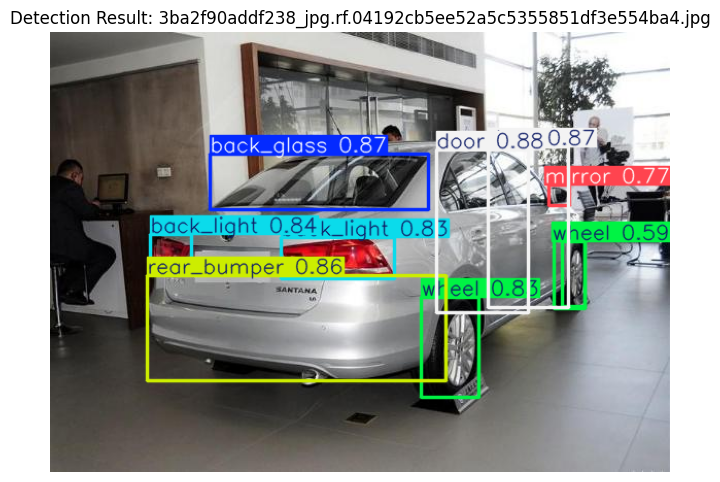


image 1/1 /content/Car-Components-Dataset-11/test/images/7439b68234a1f3_jpg.rf.a711644f0a81da1e8204cd003346a114.jpg: 480x640 1 back_light, 2 doors, 1 front_bumper, 1 front_glass, 1 front_light, 1 mirror, 2 wheels, 77.0ms
Speed: 3.3ms preprocess, 77.0ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


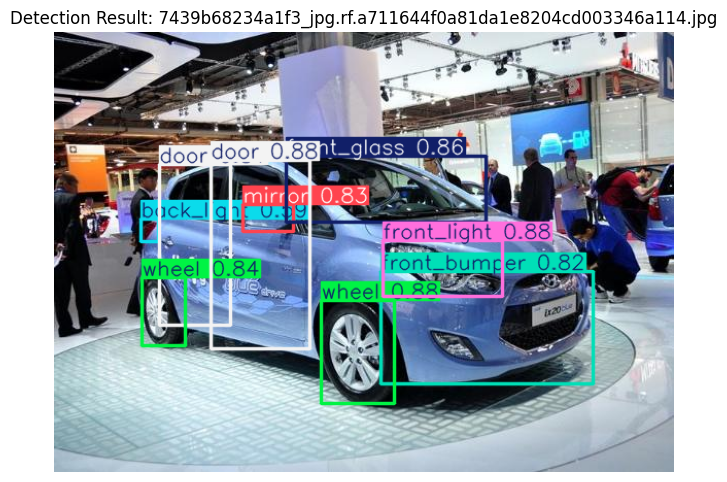


image 1/1 /content/Car-Components-Dataset-11/test/images/640117781bd560_jpg.rf.daaf3a98b61f4d11a730c9e1aa92a02f.jpg: 448x640 1 back_light, 2 doors, 1 mirror, 1 rear_bumper, 2 wheels, 125.8ms
Speed: 7.8ms preprocess, 125.8ms inference, 9.9ms postprocess per image at shape (1, 3, 448, 640)


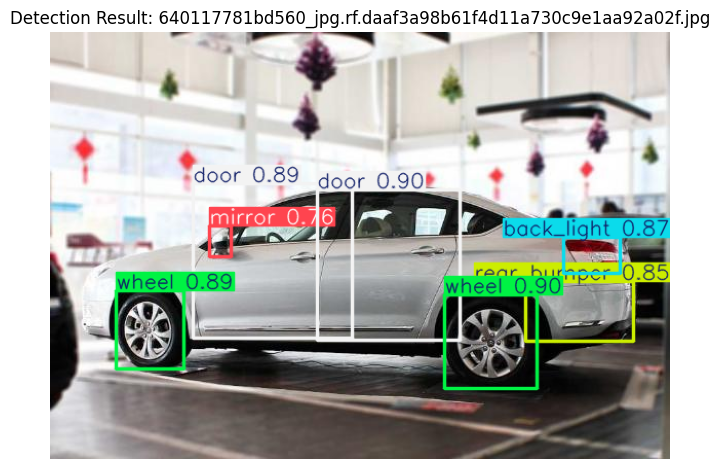


image 1/1 /content/Car-Components-Dataset-11/test/images/94fb0578bc2bb0_jpg.rf.dadbb08a300851c137ff92fe43adc940.jpg: 448x640 1 door, 1 front_bumper, 1 front_glass, 1 front_light, 1 mirror, 1 wheel, 228.2ms
Speed: 5.7ms preprocess, 228.2ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)


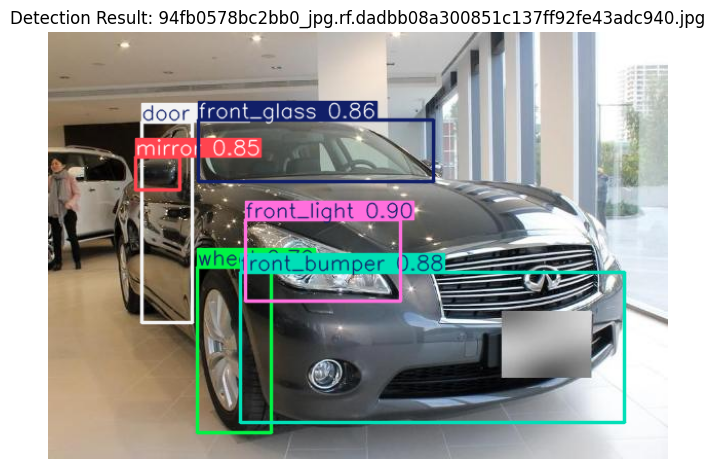


image 1/1 /content/Car-Components-Dataset-11/test/images/519732bfc28640_jpg.rf.0ad78114ca09db818c16f8625f99b48c.jpg: 448x640 1 back_light, 2 doors, 1 front_bumper, 1 front_light, 1 mirror, 1 rear_bumper, 2 wheels, 119.0ms
Speed: 3.2ms preprocess, 119.0ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)


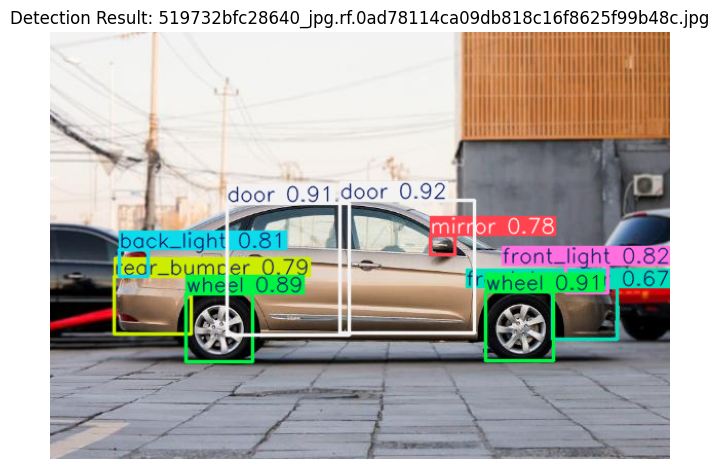


image 1/1 /content/Car-Components-Dataset-11/test/images/a8ce092ec531aa_jpg.rf.ebe95b1ed5f05318e84ca7b5bea14750.jpg: 480x640 1 back_glass, 2 back_lights, 2 doors, 1 mirror, 1 rear_bumper, 3 wheels, 241.7ms
Speed: 14.6ms preprocess, 241.7ms inference, 2.3ms postprocess per image at shape (1, 3, 480, 640)


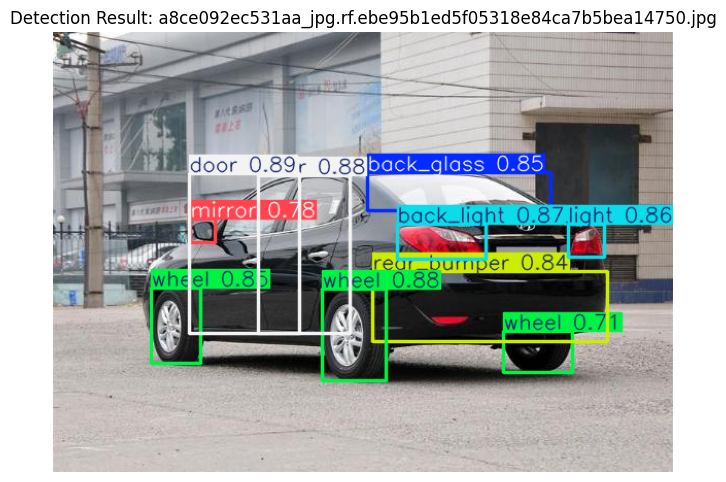


image 1/1 /content/Car-Components-Dataset-11/test/images/9ca1e3885ffa1c_jpg.rf.aae83d1706153d82ce2c0843d05fab80.jpg: 448x640 1 back_glass, 2 back_lights, 2 doors, 1 mirror, 1 rear_bumper, 3 wheels, 148.6ms
Speed: 4.1ms preprocess, 148.6ms inference, 2.2ms postprocess per image at shape (1, 3, 448, 640)


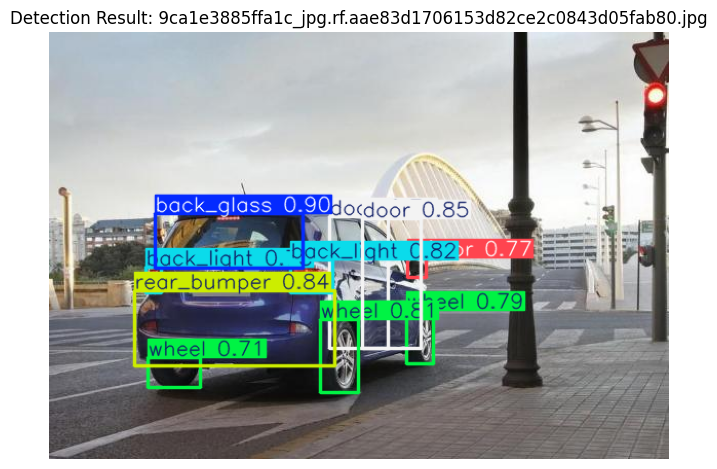


image 1/1 /content/Car-Components-Dataset-11/test/images/20ef3c1ec48beb_jpg.rf.faf0e518a3dafe122ec2c9008b0a2879.jpg: 480x640 1 back_glass, 2 back_lights, 2 doors, 1 mirror, 1 rear_bumper, 2 wheels, 51.6ms
Speed: 4.3ms preprocess, 51.6ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


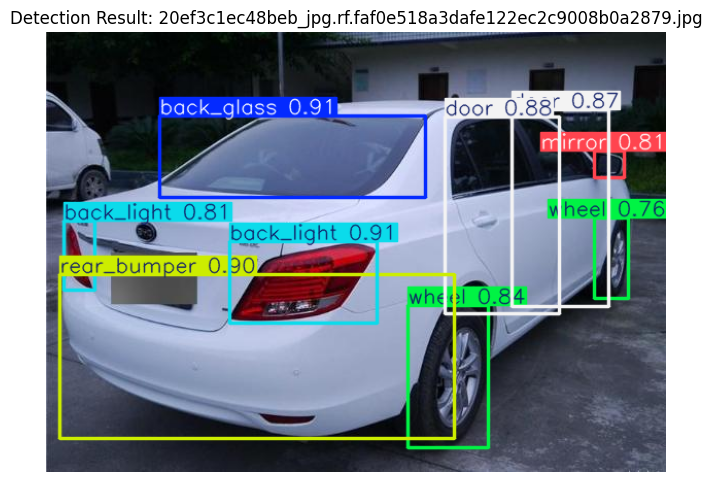

In [15]:
import os
import random
from ultralytics import YOLO
from PIL import Image
import matplotlib.pyplot as plt

# Paths
test_img_dir = "/content/Car-Components-Dataset-11/test/images"
model_path = "/content/runs/detect/yolov12-car-component-finetune/weights/best.pt"

# Load the model
model = YOLO(model_path)

# Get 20 random test images
all_imgs = [img for img in os.listdir(test_img_dir) if img.endswith(".jpg")]
selected_imgs = random.sample(all_imgs, 20)

# Run detection and show/save results
for img_name in selected_imgs:
    img_path = os.path.join(test_img_dir, img_name)

    # Inference
    results = model(img_path, conf=0.25)  # Adjust confidence threshold if needed

    # Show result in a notebook or save
    res_plotted = results[0].plot()  # returns a numpy image (BGR)

    # Display with matplotlib
    plt.figure(figsize=(8, 6))
    plt.imshow(res_plotted[..., ::-1])  # Convert BGR to RGB
    plt.title(f"Detection Result: {img_name}")
    plt.axis("off")
    plt.show()


## 🔹 Evaluation

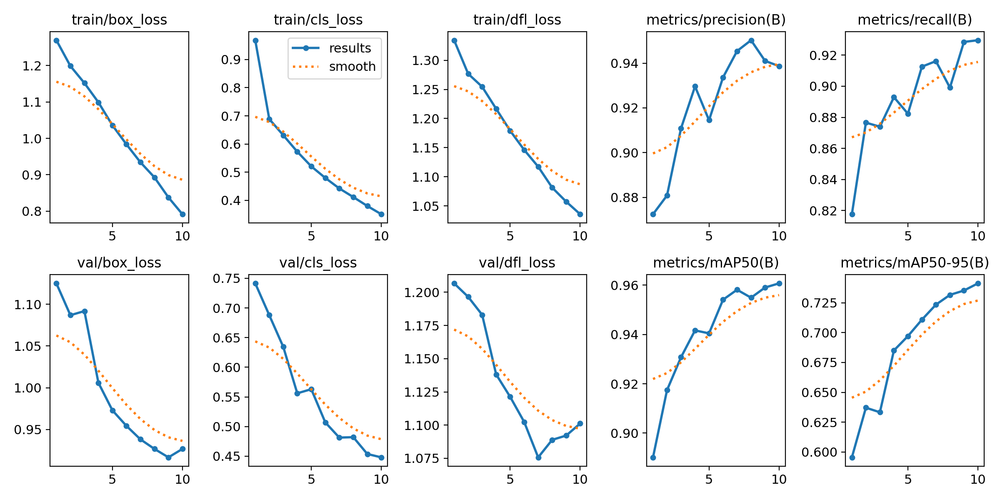

In [16]:
from IPython.display import Image

Image(filename=f'/content/runs/detect/yolov12-car-component-finetune/results.png', width=1000)

📊 Training Trend Summary (Epochs 1–10):

- All training and validation losses (box, class, dfl) show a consistent downward trend, indicating effective learning.
- Performance metrics such as precision, recall, mAP@0.5, and mAP@0.5:0.95 steadily improved:
    - mAP@0.5 increased from ~0.89 to ~0.96
    - mAP@0.5:0.95 increased from ~0.59 to ~0.74
- No signs of overfitting; validation losses decreased alongside training loss.

✅ Overall, the training was successful, stable, and well-optimized.


In [17]:
from ultralytics import YOLO

# Load model
model = YOLO("/content/runs/detect/yolov12-car-component-finetune/weights/best.pt")

# Evaluate on validation set
val_metrics = model.val(
    data="/content/Car-Components-Dataset-11/data.yaml",  # this should include val: path
    split='val',
    conf=0.25,
    iou=0.5,
    save_json=True,
    verbose=True
)

print("📊 Validation Set Evaluation Metrics:")
print(val_metrics)


Ultralytics 8.3.63 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12l summary (fused): 674 layers, 26,400,491 parameters, 0 gradients, 82.1 GFLOPs


val: Scanning /content/Car-Components-Dataset-11/valid/labels.cache... 238 images, 0 backgrounds, 0 corrupt: 100%|██████████| 238/238 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:09<00:00,  1.51it/s]


                   all        238       2041      0.945      0.928      0.954       0.76
            back_glass         98         98       0.96      0.969       0.98      0.837
            back_light        160        253      0.931      0.854      0.907      0.724
                  door        184        314      0.924      0.965      0.973      0.822
          front_bumper        140        143      0.942      0.909       0.94      0.727
           front_glass        110        110      0.972      0.955      0.976      0.863
           front_light        151        234      0.932      0.906      0.944      0.737
                mirror        222        300      0.947       0.92      0.949      0.635
           rear_bumper        139        139      0.977      0.914      0.955      0.725
                 wheel        201        450      0.924       0.96      0.962      0.769
Speed: 0.2ms preprocess, 30.5ms inference, 0.0ms loss, 2.2ms postprocess per image
Saving runs/detect/val/pred

In [18]:
# Evaluate on test set (if specified in data.yaml)
test_metrics = model.val(
    data="/content/Car-Components-Dataset-11/data.yaml",
    split='test',
    conf=0.25,
    iou=0.5,
    save_json=True,
    verbose=True
)

print("📊 Test Set Evaluation Metrics:")
print(test_metrics)


Ultralytics 8.3.63 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)


val: Scanning /content/Car-Components-Dataset-11/test/labels... 122 images, 0 backgrounds, 0 corrupt: 100%|██████████| 122/122 [00:00<00:00, 2270.65it/s]

val: New cache created: /content/Car-Components-Dataset-11/test/labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:05<00:00,  1.36it/s]


                   all        122       1016      0.938      0.936      0.957      0.754
            back_glass         38         38      0.878      0.947       0.94      0.723
            back_light         74        113      0.989      0.867      0.944      0.753
                  door         93        163      0.961      0.975      0.984      0.833
          front_bumper         75         75      0.884      0.933      0.944      0.731
           front_glass         62         62      0.989          1      0.995      0.881
           front_light         88        136      0.967      0.912      0.966      0.762
                mirror        115        157       0.98      0.946      0.968      0.652
           rear_bumper         53         54      0.845      0.907      0.911      0.718
                 wheel         99        218      0.947      0.936       0.96      0.737
Speed: 0.3ms preprocess, 31.4ms inference, 0.0ms loss, 2.8ms postprocess per image
Saving runs/detect/val2/pre

| **Dataset**                          | **mAP\@0.5** | **mAP\@0.5:0.95** | **Precision (P)** | **Recall (R)** | **Interpretation**                         |
| ------------------------------------ | ------------ | ----------------- | ----------------- | -------------- | ------------------------------------------ |
| **Training (during training phase)** | 0.961        | 0.741             | 0.939             | 0.930          | Quick eval, approximate, not final         |
| **Validation (post-training eval)**  | 0.954        | 0.760             | 0.945             | 0.928          | Accurate measurement of actual performance |
| **Test (unseen data)**               | 0.957        | 0.754             | 0.938             | 0.936          | Strong generalization, no overfitting      |


📌 What is AP and mAP in Object Detection?

AP (Average Precision) measures how well the model detects objects of a single class, combining both localization accuracy and classification confidence. It is calculated from the area under the Precision-Recall curve.

mAP (mean Average Precision) is the average of AP scores across all object classes, giving an overall performance indicator.

There are two common variants:
- **mAP@0.5**: This uses a fixed IoU threshold of 0.5. A predicted bounding box is considered correct if it overlaps more than 50% with the ground truth box. It is more lenient.
- **mAP@0.5:0.95**: This is the COCO-style evaluation. It averages the AP across multiple IoU thresholds from 0.5 to 0.95 (with a step of 0.05). It is stricter and gives a better picture of localization quality.

🔍 The confidence score affects AP/mAP: Predictions are ranked by confidence before calculating precision and recall. High-confidence wrong detections hurt precision, while missing confident detections reduce recall.


## 🔹 Downloading Iranian Car Images and Running YOLOv12 Component Detection

In [19]:
!pip install icrawler

In [21]:
import os
import random
from icrawler.builtin import GoogleImageCrawler
from ultralytics import YOLO
from PIL import Image
import matplotlib.pyplot as plt

# Set up a directory to save downloaded images
download_dir = "iranian_cars"
os.makedirs(download_dir, exist_ok=True)

# Search queries for Iranian cars
queries = ["پژو ماشین", "پراید ماشین", "سمند ماشین"]

# Function to download images
def download_images():
    crawler = GoogleImageCrawler(storage={'root_dir': download_dir})
    for query in queries:
        crawler.crawl(keyword=query, max_num=2)  # adjust per category

# Download images only if not already downloaded
if not os.listdir(download_dir):
    print("🔍 Downloading images...")
    download_images()
else:
    print("📁 Using previously downloaded images.")

📁 Using previously downloaded images.



image 1/1 /content/iranian_cars/000004.jpg: 384x640 1 back_light, 2 doors, 1 front_bumper, 1 front_light, 1 mirror, 1 rear_bumper, 2 wheels, 72.5ms
Speed: 2.7ms preprocess, 72.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


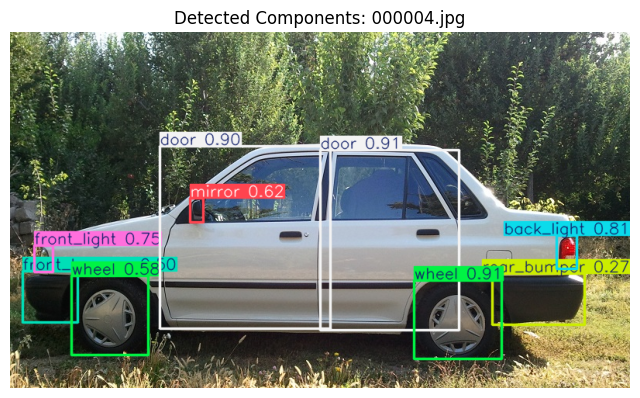

ERROR:downloader:Exception caught when downloading file https://cdn-sth1.bama.ir/uploads/BamaImages/Research/a06fbe34-8f6f-4c0b-9ab2-55e54220d058/research_637697567613597239.jpg, error: HTTPSConnectionPool(host='cdn-sth1.bama.ir', port=443): Max retries exceeded with url: /uploads/BamaImages/Research/a06fbe34-8f6f-4c0b-9ab2-55e54220d058/research_637697567613597239.jpg (Caused by ConnectTimeoutError(<urllib3.connection.HTTPSConnection object at 0x78e842ddc410>, 'Connection to cdn-sth1.bama.ir timed out. (connect timeout=5)')), remaining retry times: 2


image 1/1 /content/iranian_cars/000001.jpg: 384x640 2 doors, 1 front_bumper, 1 front_glass, 1 front_light, 1 mirror, 2 wheels, 48.3ms
Speed: 2.6ms preprocess, 48.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


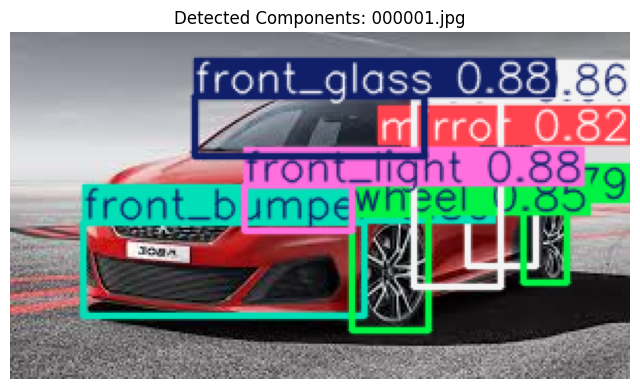


image 1/1 /content/iranian_cars/000002.jpg: 448x640 2 doors, 1 front_bumper, 1 front_glass, 2 front_lights, 2 mirrors, 2 wheels, 46.7ms
Speed: 4.1ms preprocess, 46.7ms inference, 2.9ms postprocess per image at shape (1, 3, 448, 640)


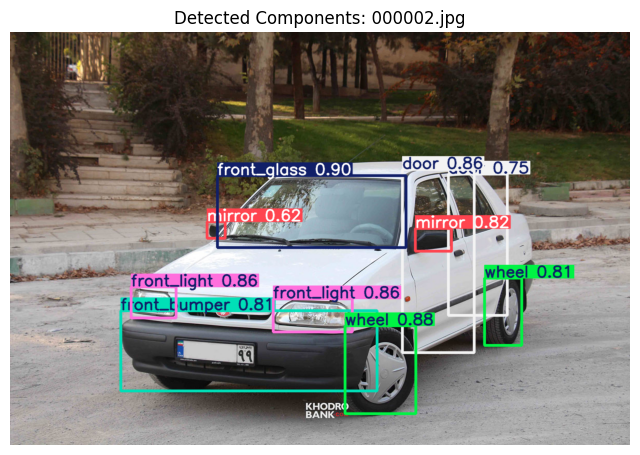


image 1/1 /content/iranian_cars/000007.jpg: 384x640 1 door, 1 front_bumper, 1 front_glass, 2 front_lights, 2 mirrors, 3 wheels, 49.7ms
Speed: 3.9ms preprocess, 49.7ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


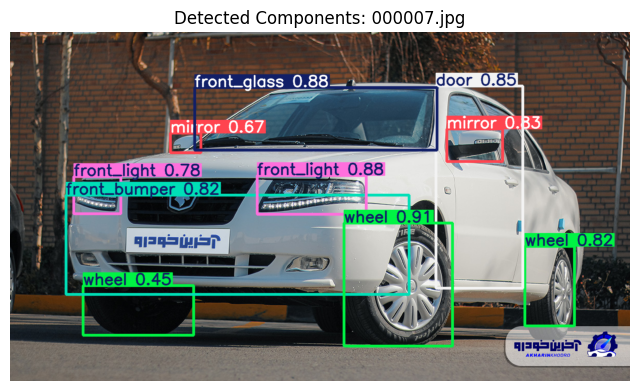


image 1/1 /content/iranian_cars/000005.jpg: 640x640 1 door, 1 front_bumper, 1 front_glass, 2 front_lights, 1 mirror, 1 wheel, 56.0ms
Speed: 4.8ms preprocess, 56.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


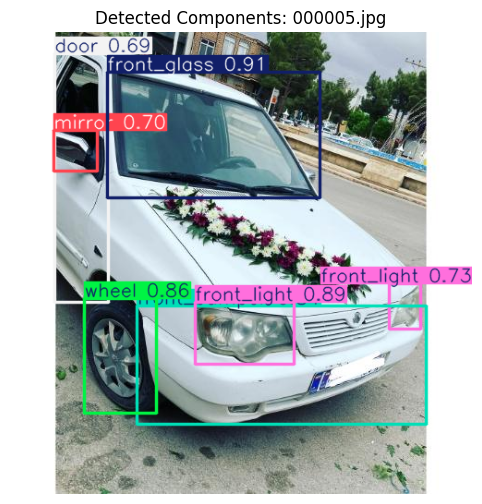


image 1/1 /content/iranian_cars/000003.jpg: 320x640 2 doors, 1 front_bumper, 1 front_glass, 2 front_lights, 2 mirrors, 3 wheels, 116.2ms
Speed: 2.6ms preprocess, 116.2ms inference, 1.4ms postprocess per image at shape (1, 3, 320, 640)


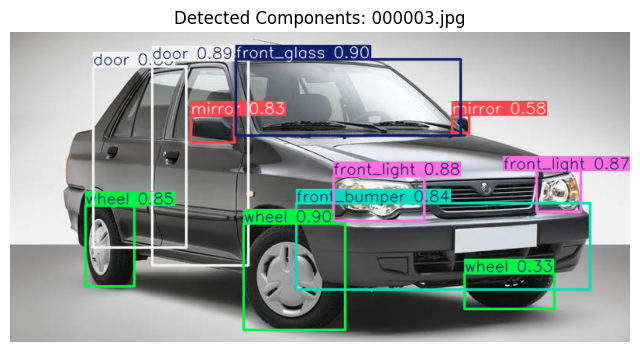


image 1/1 /content/iranian_cars/000006.jpg: 448x640 1 back_glass, 2 back_lights, 2 doors, 1 front_bumper, 1 front_light, 1 mirror, 1 rear_bumper, 3 wheels, 50.0ms
Speed: 3.9ms preprocess, 50.0ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


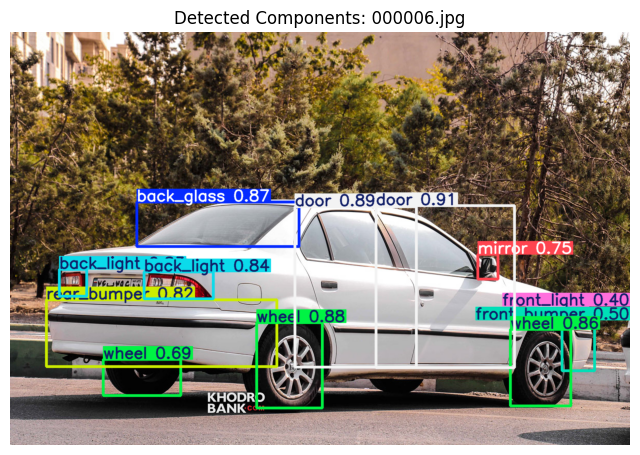

In [22]:
# Load your trained model
model_path = "/content/runs/detect/yolov12-car-component-finetune/weights/best.pt"
model = YOLO(model_path)

# Get 20 random downloaded images
all_imgs = [img for img in os.listdir(download_dir) if img.lower().endswith((".jpg", ".jpeg", ".png"))]
selected_imgs = random.sample(all_imgs, min(20, len(all_imgs)))

# Run detection
for img_name in selected_imgs:
    img_path = os.path.join(download_dir, img_name)

    try:
        # Inference
        results = model(img_path, conf=0.25)

        # Plot results (returns numpy array, BGR format)
        res_plotted = results[0].plot()

        # Show with matplotlib
        plt.figure(figsize=(8, 6))
        plt.imshow(res_plotted[..., ::-1])  # BGR to RGB
        plt.title(f"Detected Components: {img_name}")
        plt.axis("off")
        plt.show()
    except Exception as e:
        print(f"❌ Error processing {img_name}: {e}")